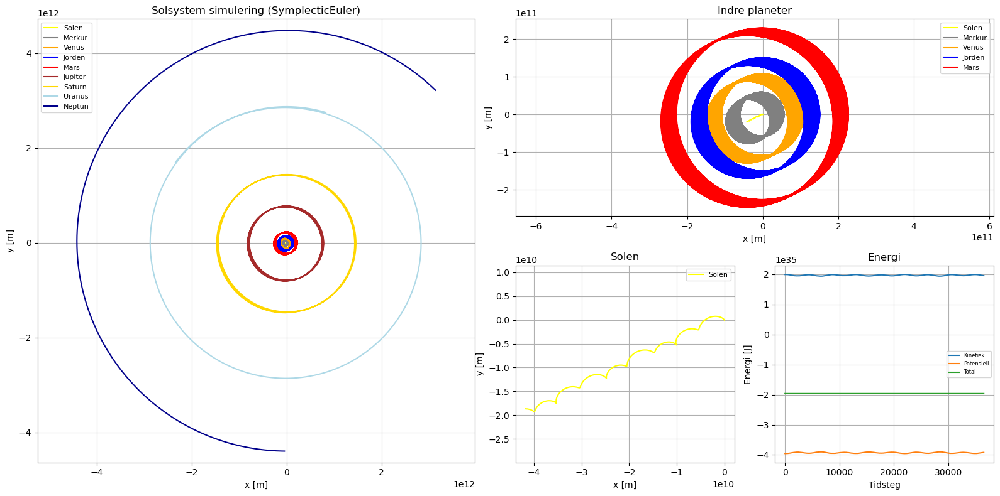

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# ---------------------------------------------------
# PARAMETERE
# ---------------------------------------------------
G = 6.67*10**(-11)  # gravitasjonskonstant
dt = 60*60*24*1 # tidsskritt
t_max = 60*60*24*365*100  # simuleringstid
metode = 'SymplecticEuler'  # velg: 'EulerF', 'EulerB', 'RK4', 'SymplecticEuler'

# Animasjon
window = int(360 * 60*60*24/dt)  # siste 360 dager tegnes
plot_every = int(360 * 60*60*24/dt)


# Definer planeter: [x, y, vx, vy, masse]
# Originale avstander fra solen (r)
radii = np.array([0.0, 5.79e10, 1.082e11, 1.496e11, 2.279e11, 
                  7.785e11, 1.433e12, 2.872e12, 4.495e12], dtype=np.float64)

# Originale hastigheter (antatt sirkulær bane)
speeds = np.array([0.0, 4.79e4, 3.5e4, 2.978e4, 2.41e4, 
                   1.31e4, 9.7e3, 6.8e3, 5.4e3], dtype=np.float64)

masses = np.array([1.989e30, 3.3e23, 4.87e24, 5.97e24, 0.642e24, 
                   1898e24, 568e24, 86.8e24, 102e24], dtype=np.float64)

# Tilfeldig fase
theta = np.random.uniform(0, 2*np.pi, size=len(radii))

# Startposisjon
x = radii * np.cos(theta)
y = radii * np.sin(theta)

# Start-hastighet (perpendikulær på radiusvektor, positiv tangentiell)
vx = -speeds * np.sin(theta)
vy =  speeds * np.cos(theta)

bodies = np.column_stack([x, y, vx, vy, masses])

planet_names = ['Solen','Merkur','Venus','Jorden','Mars','Jupiter','Saturn','Uranus','Neptun']
planet_colors = ['yellow','gray','orange','blue','red','brown','gold','lightblue','darkblue']

N = len(bodies)

# Lagre posisjoner og energi
positions = [bodies[:, :2].copy()]
KE = []
PE = []

# ---------------------------------------------------
# FUNKSJONER
# ---------------------------------------------------
def accelerations(bodies):
    """Beregn akselerasjon på hver kropp pga gravitasjon."""
    a = np.zeros((N, 2))
    for i in range(N):
        for j in range(N):
            if i != j:
                r_vec = bodies[j, :2] - bodies[i, :2]
                r = np.linalg.norm(r_vec)
                if r <= 10**9:
                    a[i] += 0
                else:
                    a[i] += G * bodies[j, 4] * r_vec / r**3
    return a

def total_energy(bodies):
    """Kinetisk + potensiell energi."""
    ke = 0.5 * np.sum(bodies[:, 4] * np.sum(bodies[:, 2:4]**2, axis=1))
    pe = 0
    for i in range(N):
        for j in range(i+1, N):
            r = np.linalg.norm(bodies[j, :2] - bodies[i, :2])
            pe -= G * bodies[i, 4] * bodies[j, 4] / r
    return ke, pe

# ---------------------------------------------------
# TIDSINTEGRASJON
# ---------------------------------------------------
t = 0.0
while t < t_max:
    a = accelerations(bodies)
    
    if metode == 'EulerF':
        bodies[:, :2] += bodies[:, 2:4] * dt
        bodies[:, 2:4] += a * dt
    elif metode == 'EulerB':
        # Implisitt Euler, kun sol-planet gravitasjon
        bodies_new = bodies.copy()
        tol = 1e-6
        max_iter = 50

        for i in range(1, N):  # Start fra 1, skip solen
            pos_old = bodies[i, :2].copy()
            vel_old = bodies[i, 2:4].copy()

            # Initial gjetning: bruk eksplisitt Euler
            pos_guess = pos_old + dt * vel_old
            vel_guess = vel_old + dt * (-G * bodies[0,4] * pos_guess / np.linalg.norm(pos_guess)**3)

            for it in range(max_iter):
                a_new = -G * bodies[0,4] * pos_guess / np.linalg.norm(pos_guess)**3
                vel_new = vel_old + dt * a_new
                pos_new = pos_old + dt * vel_new

                if np.allclose(pos_new, pos_guess, atol=tol):
                    break

                pos_guess = pos_new
                vel_guess = vel_new

            bodies_new[i, :2] = pos_new
            bodies_new[i, 2:4] = vel_new

        bodies[:, :2] = bodies_new[:, :2]
        bodies[:, 2:4] = bodies_new[:, 2:4]
    elif metode == 'SymplecticEuler':
        a_n = accelerations(bodies)               # akselerasjon beregnet ved r_n
        bodies[:, 2:4] += a_n * dt                # v_{n+1}
        bodies[:, :2] += bodies[:, 2:4] * dt      # r_{n+1}
    elif metode == 'RK4':
        # Lag kopier for RK4
        r1, v1 = bodies[:, :2].copy(), bodies[:, 2:4].copy()
        a1 = accelerations(bodies)
        
        r2 = r1 + 0.5*dt*v1
        v2 = v1 + 0.5*dt*a1
        bodies2 = bodies.copy()
        bodies2[:, :2] = r2
        bodies2[:, 2:4] = v2
        a2 = accelerations(bodies2)
        
        r3 = r1 + 0.5*dt*v2
        v3 = v1 + 0.5*dt*a2
        bodies3 = bodies.copy()
        bodies3[:, :2] = r3
        bodies3[:, 2:4] = v3
        a3 = accelerations(bodies3)
        
        r4 = r1 + dt*v3
        v4 = v1 + dt*a3
        bodies4 = bodies.copy()
        bodies4[:, :2] = r4
        bodies4[:, 2:4] = v4
        a4 = accelerations(bodies4)
        
        bodies[:, :2] += dt/6*(v1 + 2*v2 + 2*v3 + v4)
        bodies[:, 2:4] += dt/6*(a1 + 2*a2 + 2*a3 + a4)
    
    else:
        raise ValueError("Metode må være 'EulerF' eller 'RK4'")
    
    # Lagre posisjoner og energi
    positions.append(bodies[:, :2].copy())
    ke, pe = total_energy(bodies)
    KE.append(ke)
    PE.append(pe)
    
    t += dt


positions = np.array(positions)
KE = np.array(KE)
PE = np.array(PE)

# ---------------------------------------------------
# PLOTT MED DELT HØYRE SIDE
# ---------------------------------------------------
fig = plt.figure(figsize=(16,8))
gs = GridSpec(2, 3, width_ratios=[2,1,1], height_ratios=[1,1], figure=fig)

# Store akser
ax_main = fig.add_subplot(gs[:,0])   # Hovedplott
ax_inner = fig.add_subplot(gs[0,1:]) # Øverst til høyre: indre planeter
ax_sun = fig.add_subplot(gs[1,1])    # Nederst til høyre venstre: Solen
ax_energy = fig.add_subplot(gs[1,2]) # Nederst til høyre høyre: energi

# Hovedplott (hele solsystemet)
for i in range(N):
    ax_main.plot(positions[:,i,0], positions[:,i,1], color=planet_colors[i], label=planet_names[i])
ax_main.set_xlabel("x [m]")
ax_main.set_ylabel("y [m]")
ax_main.set_title(f"Solsystem simulering ({metode})")
ax_main.axis('equal')
ax_main.grid(True)
ax_main.legend(fontsize=8)

# Indre planeter
for i in range(5):
    ax_inner.plot(positions[:,i,0], positions[:,i,1], color=planet_colors[i], label=planet_names[i])
ax_inner.set_xlabel("x [m]")
ax_inner.set_ylabel("y [m]")
ax_inner.set_title("Indre planeter")
ax_inner.axis('equal')
ax_inner.grid(True)
ax_inner.legend(fontsize=8)

# Solen
ax_sun.plot(positions[:,0,0], positions[:,0,1], color=planet_colors[0], label=planet_names[0])
ax_sun.set_xlabel("x [m]")
ax_sun.set_ylabel("y [m]")
ax_sun.set_title("Solen")
ax_sun.axis('equal')
ax_sun.grid(True)
ax_sun.legend(fontsize=8)

# Energi
ax_energy.plot(KE, label="Kinetisk")
ax_energy.plot(PE, label="Potensiell")
ax_energy.plot(KE+PE, label="Total")
ax_energy.set_xlabel("Tidsteg")
ax_energy.set_ylabel("Energi [J]")
ax_energy.set_title("Energi")
ax_energy.legend(fontsize=6)
ax_energy.grid(True)

plt.tight_layout()
plt.show()



# ---------------------------------------------------
# ANIMASJON
# ---------------------------------------------------
fig = plt.figure(figsize=(16,8))
gs = GridSpec(2, 3, width_ratios=[2,1,1], height_ratios=[1,1], figure=fig)

# Akser
ax_main = fig.add_subplot(gs[:,0])   # Hovedplott
ax_inner = fig.add_subplot(gs[0,1:]) # Øvre høyre
ax_sun = fig.add_subplot(gs[1,1])    # Nederst høyre venstre
ax_energy = fig.add_subplot(gs[1,2]) # Nederst høyre høyre

# Linjer og punkter for animasjon
lines_main = [ax_main.plot([],[], color=planet_colors[i])[0] for i in range(N)]
points_main = [ax_main.plot([],[], 'o', color=planet_colors[i])[0] for i in range(N)]

lines_inner = [ax_inner.plot([],[], color=planet_colors[i])[0] for i in range(5)]
points_inner = [ax_inner.plot([],[], 'o', color=planet_colors[i])[0] for i in range(5)]

lines_sun = [ax_sun.plot([],[], color=planet_colors[0])[0]]
points_sun = [ax_sun.plot([],[], 'o', color=planet_colors[0])[0]]

# Axis settings
ax_main.set_xlim(-5e12,5e12)
ax_main.set_ylim(-5e12,5e12)
ax_main.set_xlabel("x [m]")
ax_main.set_ylabel("y [m]")
ax_main.set_title("Hovedsolsystemet")
ax_main.grid(True)

ax_inner.set_xlim(-3e11,3e11)
ax_inner.set_ylim(-3e11,3e11)
ax_inner.set_xlabel("x [m]")
ax_inner.set_ylabel("y [m]")
ax_inner.set_title("Indre planeter")
ax_inner.grid(True)

ax_sun.set_xlim(-2e10,2e10)
ax_sun.set_ylim(-2e10,2e10)
ax_sun.set_xlabel("x [m]")
ax_sun.set_ylabel("y [m]")
ax_sun.set_title("Solen")
ax_sun.grid(True)

ax_energy.set_xlabel("Tidsteg")
ax_energy.set_ylabel("Energi [J]")
ax_energy.set_title("Energi over tid")
ax_energy.set_xlim(0,len(KE))
all_energy = np.hstack([KE, PE, KE+PE])
ax_energy.set_ylim(np.min(all_energy)*0.9, np.max(all_energy)*1.1)
ax_energy.grid(True)

# Før animasjonen, initialiser linjene:
KE = np.array(KE)
PE = np.array(PE)

line_ke, = ax_energy.plot([], [], label="Kinetisk")
line_pe, = ax_energy.plot([], [], label="Potensiell")
line_te, = ax_energy.plot([], [], label="Total")
ax_energy.legend(fontsize=6)


def init():
    # planetbaner
    for line_list in [lines_main, points_main, lines_inner, points_inner, lines_sun, points_sun]:
        for l in line_list:
            l.set_data([],[])
    # energi
    line_ke.set_data([],[])
    line_pe.set_data([],[])
    line_te.set_data([],[])
    return lines_main + points_main + lines_inner + points_inner + lines_sun + points_sun + [line_ke, line_pe, line_te]

def update(frame):
    start = max(0, frame-window)
    # Hovedplott
    for i, (line, point) in enumerate(zip(lines_main, points_main)):
        line.set_data(positions[start:frame,i,0].copy(), positions[start:frame,i,1].copy())
        point.set_data([positions[frame-1,i,0]], [positions[frame-1,i,1]])
    # Indre planeter
    for i, (line, point) in enumerate(zip(lines_inner, points_inner)):
        line.set_data(positions[start:frame,i,0].copy(), positions[start:frame,i,1].copy())
        point.set_data([positions[frame-1,i,0]], [positions[frame-1,i,1]])
    # Solen
    lines_sun[0].set_data(positions[start:frame,0,0].copy(), positions[start:frame,0,1].copy())
    points_sun[0].set_data([positions[frame-1,0,0]], [positions[frame-1,0,1]])
    # Energi
    line_ke.set_data(np.arange(frame), KE[:frame])
    line_pe.set_data(np.arange(frame), PE[:frame])
    line_te.set_data(np.arange(frame), KE[:frame]+PE[:frame])
    return lines_main + points_main + lines_inner + points_inner + lines_sun + points_sun + [line_ke, line_pe, line_te]



ani = FuncAnimation(fig, update, frames=range(0,len(positions),int(plot_every)), init_func=init, blit=False, interval=50)
plt.close(fig)

HTML(ani.to_jshtml())





In [27]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import solve_ivp
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# --- Parametere (kretsverdier) ---
R = 100.0       # Ohm
L = 10e-3       # Henry
C = 1e-5       # Farad
mu = R * np.sqrt(C / L)
print(f"μ = {mu:.3f}")

# --- Van der Pol-ODE ---
def van_der_pol(t, y):
    x, dx = y
    ddx = mu * (1 - x**2) * dx - x
    return [dx, ddx]

# --- Integrasjon for flere startverdier ---
t_span = (0, 20)
t_eval = np.linspace(*t_span, 2000)

# Liste over startverdier [x0, dx0]
start_values = [[1.0, 0.0], [0.5, 0.0], [-1.0, 0.5], [0.0, -1.0]]
solutions = [solve_ivp(van_der_pol, t_span, y0, t_eval=t_eval) for y0 in start_values]

# --- Sett opp figur ---
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
colors = ["C0", "C1", "C2", "C3"]

# Plot full tidsserie for hver løsning (statisk)
for sol, c in zip(solutions, colors):
    ax1.plot(sol.t, sol.y[0], color=c, lw=1.5, label=f"x0={sol.y[0,0]:.1f}")

# Moving dots for tidsserie (optional)
dots_time = [ax1.plot([], [], "o", color=c)[0] for c in colors]

# Faseplanspor og prikker
lines_phase = [ax2.plot([], [], lw=2, color=c)[0] for c in colors]
dots_phase = [ax2.plot([], [], "o", color=c)[0] for c in colors]

# --- Akser og stil ---
ax1.set_xlim(t_span)
ax1.set_ylim([-3, 3])
ax1.set_xlabel("t")
ax1.set_ylabel("q(t)")
ax1.set_title("Tidserier")
ax1.legend()
ax1.grid(True)

ax2.set_xlabel("q")
ax2.set_ylabel("I = dq/dt")
ax2.set_title("Faseplan")
ax2.set_xlim([-3, 3])
ax2.set_ylim([-7, 7])
ax2.grid(True)
plt.tight_layout()

# --- Init og oppdateringsfunksjoner ---
def init():
    for dt, lp, dp in zip(dots_time, lines_phase, dots_phase):
        dt.set_data([], [])
        lp.set_data([], [])
        dp.set_data([], [])
    return dots_time + lines_phase + dots_phase

def update(i):
    for sol, dt, lp, dp in zip(solutions, dots_time, lines_phase, dots_phase):
        t, x, dx = sol.t, sol.y[0], sol.y[1]
        # Dot moves along full time trace (which is static)
        dt.set_data([t[i]], [x[i]])
        # Phase plane curve grows dynamically
        lp.set_data(x[:i+1], dx[:i+1])
        dp.set_data([x[i]], [dx[i]])
    return dots_time + lines_phase + dots_phase

# --- Lag animasjon ---
plot_every = 20
ani = FuncAnimation(fig, update, frames=range(0, len(t_eval), plot_every),
                    init_func=init, blit=False, interval=30)
plt.close(fig)

# --- Vis HTML5-video direkte ---
HTML(ani.to_jshtml())



μ = 3.162
